In [47]:
import os
from os import listdir, mkdir
from os.path import isfile, join
import re

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pywt
import seaborn as sns
from sklearn import datasets
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

In [16]:
def getCsiMatrFromCsv(fileName: str, CsiFilesFolder: str) -> pd.DataFrame:
    csvFilePath = join(CsiFilesFolder, fileName)
    return pd.read_csv(csvFilePath)


def getCsiDictFromDataset(dataset_folder: str = "dataset") -> {str: pd.DataFrame}:
    csi_dict: {str: pd.DataFrame} = dict()
    csiFiles = [fileName for fileName in listdir(dataset_folder) if isfile(join(dataset_folder, fileName))]
    for idx, fileName in enumerate(csiFiles):
        csi_matrix = getCsiMatrFromCsv(fileName, dataset_folder)
        # csi_matrix.head(2)
        csi_dict[fileName] = csi_matrix
    return csi_dict


def upload2Dataset(csi_dict: {str: pd.DataFrame}, csi_cvs_folder: str = "dataset", csvFileName: str = ""):
    # fileName == "fileName.csv"
    csi_cvs_folder = csi_cvs_folder
    if isinstance(csi_dict, pd.DataFrame):
        csi_dict.to_csv(join(csi_cvs_folder, csvFileName), index=False)
        return

    for fileName in csi_dict:
        csvFileName = fileName[:-3] + "csv"
        csi_dict[fileName].to_csv(join(csi_cvs_folder, csvFileName), index=False)

## Download csi_dict

In [17]:
dataset_folder = "dataset"
csi_dict = getCsiDictFromDataset(dataset_folder)

## PCA preparation

### change all NaN and +-inf values in file to median of corresponding packet or delete the packet if those values too much

In [18]:
for fileName in csi_dict:
    csi_matrix = csi_dict[fileName]
    # print(csi_matrix)
    csi_matrix.replace(np.inf, np.nan, inplace=True)
    csi_matrix.replace(-np.inf, np.nan, inplace=True)
    for idx in range(len(csi_matrix.index.values)):
        packet = csi_matrix.iloc[idx]
        stateMass = ((packet == np.nan) | (packet == np.inf) | (packet == -np.inf))
        stateMassSum = stateMass.sum()

        if 0 < stateMassSum < (0.3 * len(packet)):
            csi_matrix.iloc[idx].replace(np.nan, packet.mean(), inplace=True)

    csi_matrix.replace(np.nan, csi_matrix.mean(), inplace=True)
    csi_dict[fileName] = csi_matrix



##### check if  NaN, +-inf present in files

In [19]:
for fileName in csi_dict:
    csi_matrix = csi_dict[fileName]
    for idx in csi_matrix.index.values:
        packet = csi_matrix.iloc[idx]
        if any((packet == np.nan) | (packet == np.inf) | (packet == -np.inf)):
            print(fileName, idx)

### data standardization


In [20]:
for fileName in csi_dict:
    csi_matrix = csi_dict[fileName]
    csi_dict[fileName] = pd.DataFrame(StandardScaler().fit_transform(csi_matrix))


### splitting dataset to train and test part and creating one DataFrame with all data from train dataset part

In [21]:
actions_dict: {str: [str, ]} = dict()
for fileName in csi_dict:
    actionName = re.sub(r"_\d{1,2}.csv", "", fileName)
    if actions_dict.get(actionName, -1) == -1:
        actions_dict[actionName] = []
    actions_dict[actionName].append(fileName)

train_filesName = []
test_filesName = []

train_size = 0.75

In [22]:
for actionName in actions_dict:
    files_list = actions_dict[actionName]
    splitIdx = int(len(files_list) * train_size)
    train_filesName.extend(files_list[:splitIdx])
    test_filesName.extend(files_list[splitIdx:])

In [23]:
train_dataset_path = "dataset/train_part"
test_dataset_path = "dataset/test_part"

if not os.path.exists(train_dataset_path):
    mkdir(train_dataset_path)

if not os.path.exists(test_dataset_path):
    mkdir(test_dataset_path)

trainDf = pd.DataFrame()

for fileName in csi_dict:
    csi_matrix = csi_dict[fileName]
    if fileName in train_filesName:
        upload2Dataset(csi_matrix, csi_cvs_folder=train_dataset_path, csvFileName=fileName)
        trainDf = pd.concat([trainDf, csi_matrix])

    elif fileName in test_filesName:
        upload2Dataset(csi_matrix, csi_cvs_folder=test_dataset_path, csvFileName=fileName)

trainDf

,0,1,2,3,4,5,6,7,8,9,...,232,233,234,235,236,237,238,239,240,241
0,-3.710793,-0.550789,-0.883065,-0.735000,-0.627313,-0.570158,-0.568012,-0.534066,-0.575755,-0.524064,...,0.899171,0.843654,1.167198,-0.630921,0.724621,0.640599,-1.835735,-0.922583,-0.957357,-0.198039
1,-0.449580,0.132744,-0.380830,-0.429731,-0.446967,-0.425851,-0.405613,-0.415849,-0.470930,-0.484014,...,1.013279,-1.248784,0.473580,0.702455,-0.704943,-1.216900,1.033506,0.688956,0.410349,-1.018735
2,0.031912,0.769780,0.611769,0.457889,0.291151,0.108149,-0.077321,-0.290329,-0.569604,-0.831355,...,-0.444445,0.517219,1.060625,-0.949776,-0.954135,0.268504,0.969995,0.679855,-2.041928,0.274596
3,0.794412,0.123536,0.522060,0.385494,0.251128,0.075454,-0.111176,-0.356399,-0.633951,-1.032908,...,0.977784,-1.887178,0.847041,-2.772851,-0.126358,1.320867,-2.019570,-1.517158,-0.197048,0.061040
4,0.635428,0.095374,0.455880,0.395725,0.268011,0.154107,-0.021113,-0.276699,-0.502370,-0.738886,...,-0.701068,-1.270930,1.120413,-0.441800,0.958626,-0.621524,-2.687738,-1.742606,-0.221521,-0.829722
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183,0.473182,0.911780,1.026388,1.011027,0.981141,0.970885,0.973170,0.963466,0.948643,0.906854,...,0.375680,1.846120,0.699415,0.223836,0.579544,0.046735,0.975848,1.212957,0.728853,1.054413
184,0.584625,-3.162919,-0.699331,-0.683668,-0.679814,-0.662911,-0.652421,-0.640659,-0.626538,-0.513951,...,0.307363,0.286112,-0.353213,0.423141,-4.052663,0.337196,-0.829786,-3.489563,0.766737,-0.843253
185,0.156199,-1.642184,0.784999,0.923557,1.001224,1.005749,0.991515,0.969380,0.926387,0.937083,...,0.259660,0.228105,-1.622327,0.807954,0.885906,1.167854,0.418787,0.530978,0.531754,1.193620
186,0.960785,0.844339,1.201550,1.187630,1.181027,1.193539,1.226965,1.256593,1.276920,1.269883,...,1.141697,1.123154,0.932102,0.272510,1.861816,0.724346,0.876287,1.312816,-0.513578,0.869705


## PCA transformation

In [25]:
pca = PCA(n_components=4)
pca.fit(trainDf)
pca.explained_variance_ratio_

array([0.1471263 , 0.05965539, 0.04795445, 0.02538584])

In [34]:
components_dict: {str: pd.DataFrame} = dict()
for fileName in train_filesName:
    components_dict[fileName] = pd.DataFrame(pca.transform(csi_dict[fileName]))

Text(0.5, 5, 'Falldown_1')

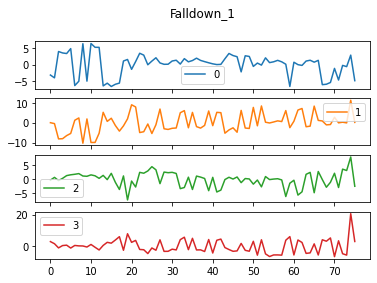

In [45]:
fileName = list(components_dict.keys())[0]
compon_matrix = components_dict[fileName]
compon_matrix.plot.line(subplots=True)
plt.title(fileName[:-4], y=5)

### Components plot

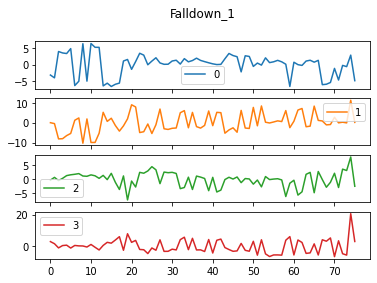

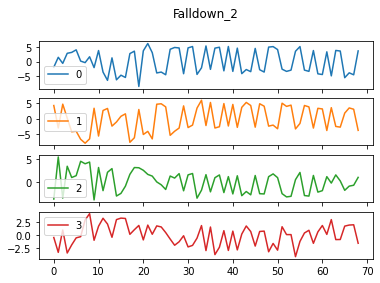

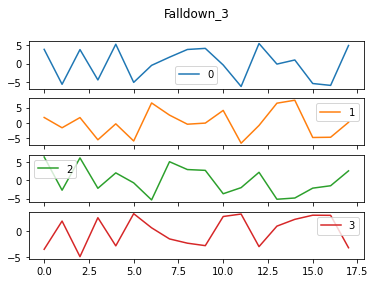

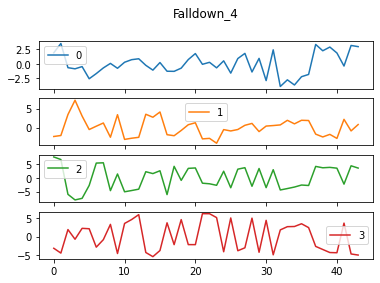

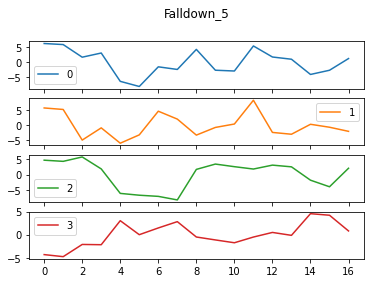

...

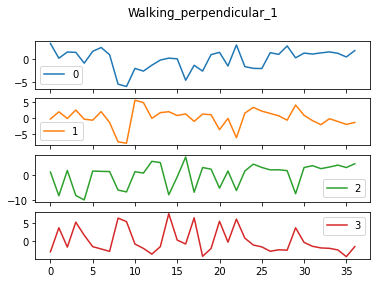

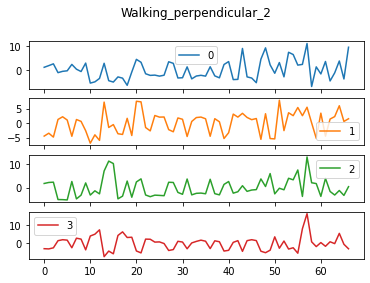

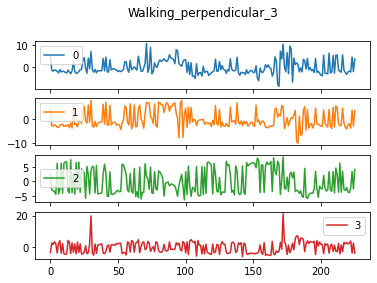

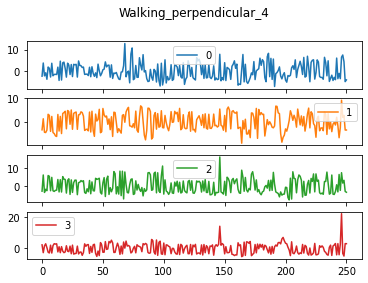

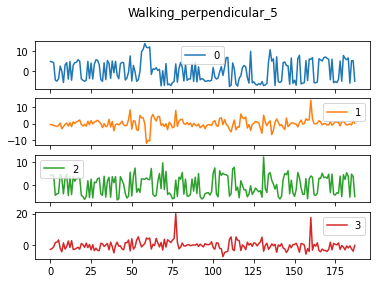

In [44]:
for fileName in components_dict:
    components_dict[fileName].plot.line(subplots=True)
    plt.title(fileName[:-4], y=5)
    plt.savefig(f"pictures/dataset/files_components_plot/dataset_components_plot_{fileName[:-4]}.jpg",
                bbox_inches="tight")
    plt.show()

### CWT


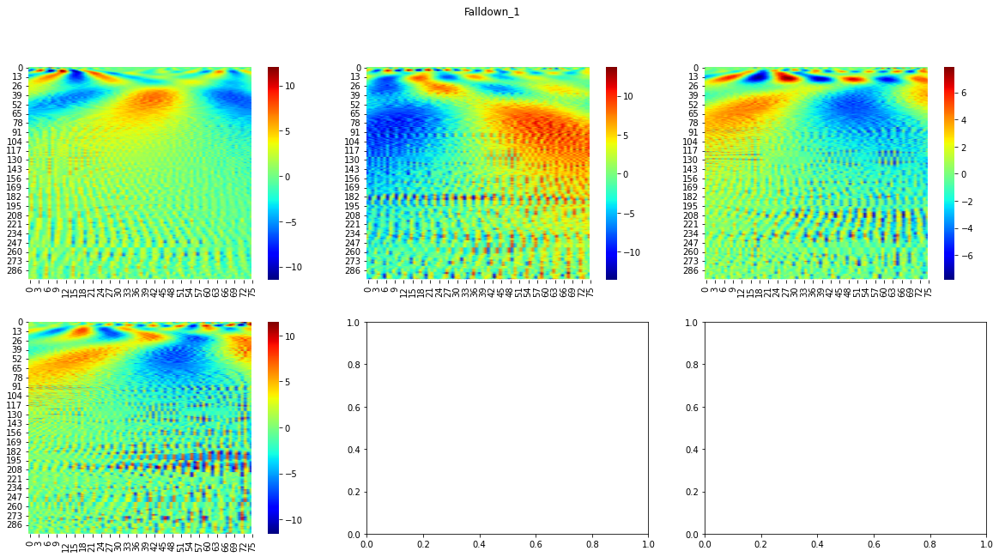

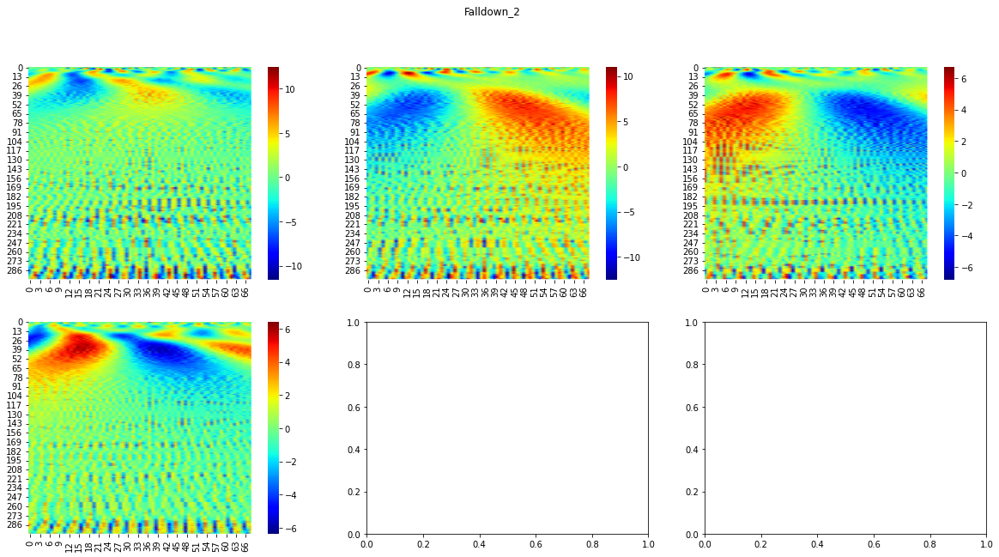

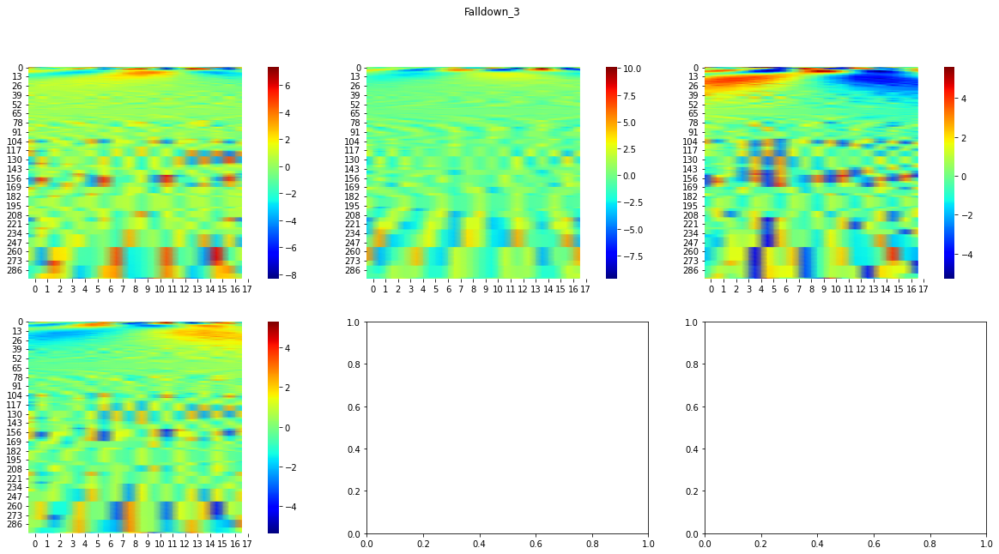

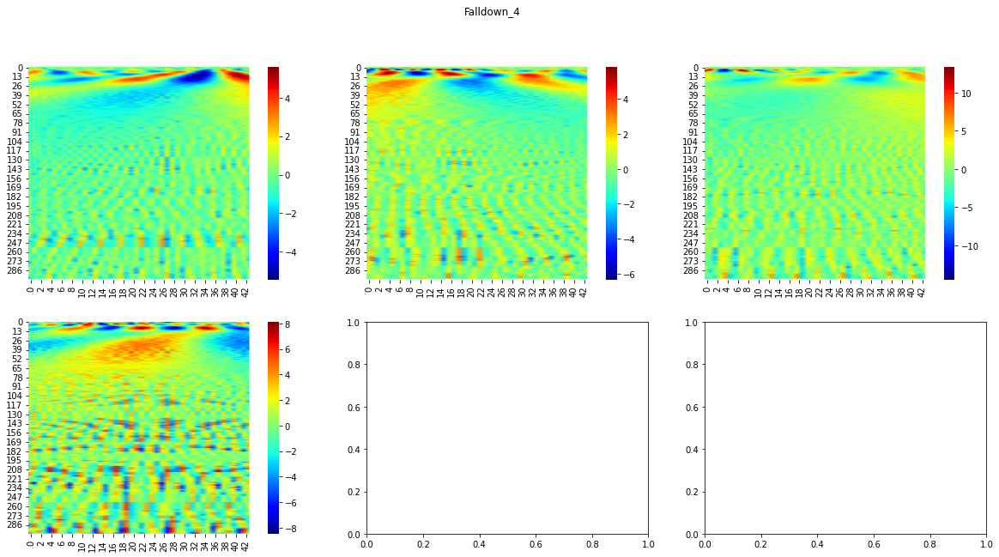

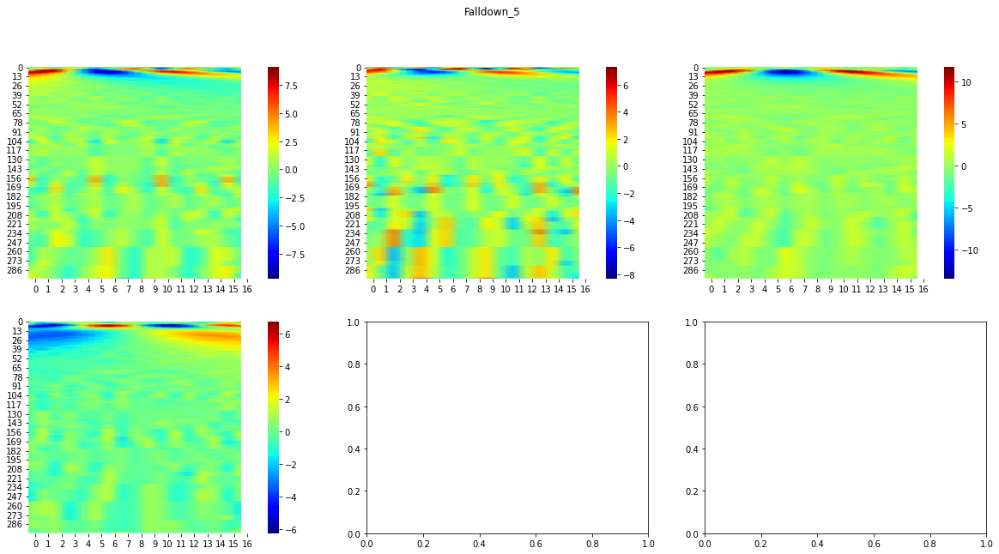

...

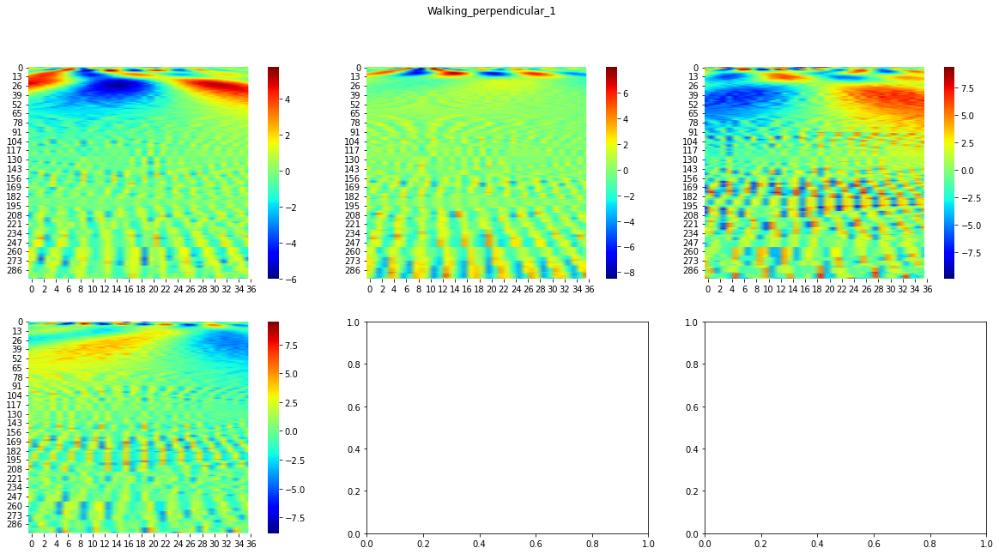

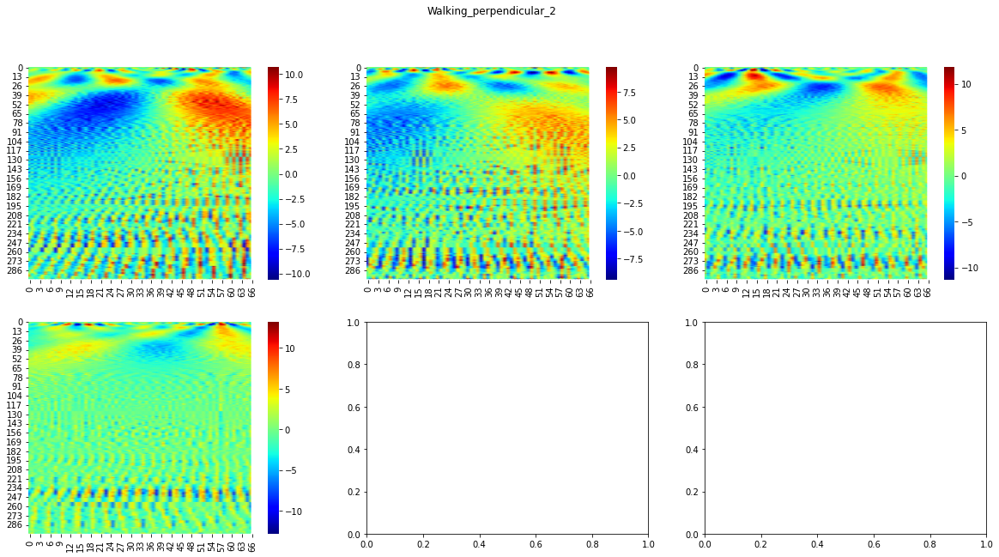

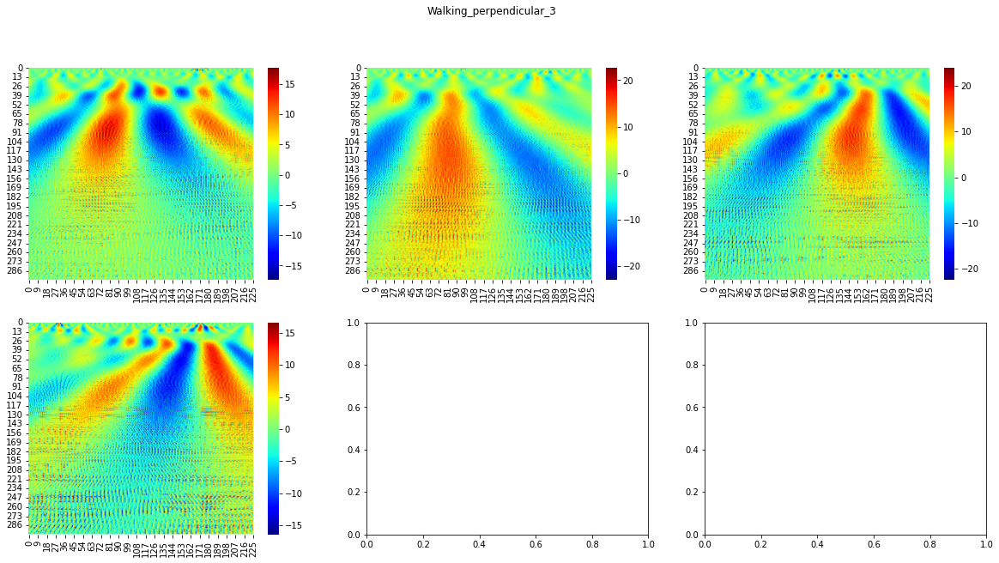

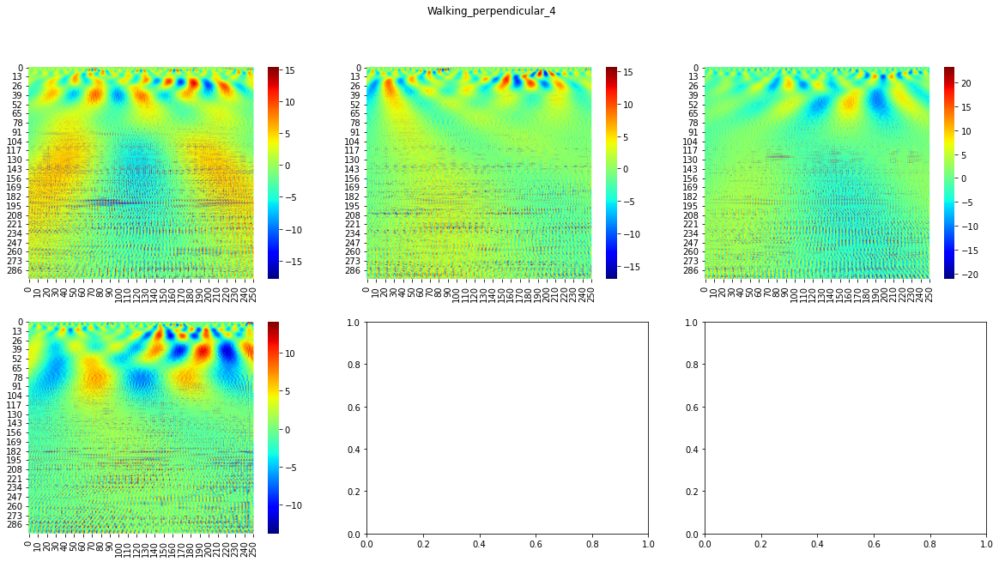

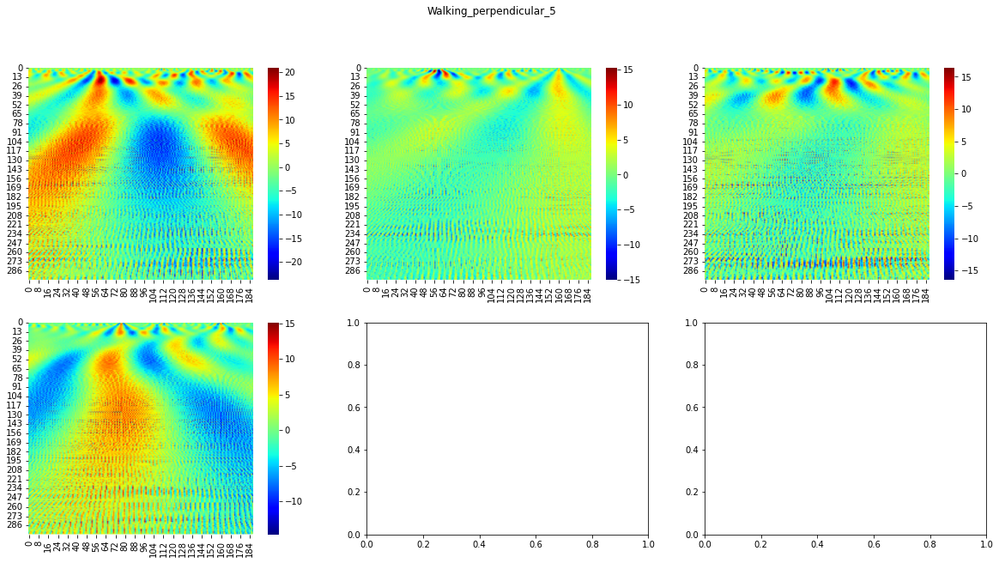

In [71]:
for fileName in components_dict:
    compon_matrix = components_dict[fileName]
    rowsN = (compon_matrix.shape[1] // 3) + 1
    colsN = 3
    fig, axes = plt.subplots(rowsN, colsN, figsize=(20, 10))
    fig.suptitle(fileName[:-4])
    colI = 0
    rowI = 0
    for idx in compon_matrix.columns:
        coef, freqs = pywt.cwt(compon_matrix[idx], np.arange(1,300), "morl")
        sns.heatmap(coef, ax=axes[rowI, colI], cmap='jet', shading='gouraud')

        colI += 1
        if colI == colsN:
            rowI += 1
            colI = 0
    plt.savefig(f"pictures/dataset/files_components_wavelet_heatmap/dataset_components_wavelet_heatmap_{fileName[:-4]}.jpg",
                bbox_inches="tight")
    plt.show()

,0,1,2,3,4,5,6,7,8,9,...,66,67,68,69,70,71,72,73,74,75
0,-0.067579,1.373762,0.061842,-0.981872,0.146577,-1.358994,0.050159,2.708118,-1.456188,-0.026793,...,-0.837847,-0.054612,0.997751,0.521413,-0.493226,0.009729,0.399996,-0.137221,-0.914457,0.180356
1,1.611156,-2.089417,0.241863,2.538373,-3.848111,2.035038,2.837739,-7.092053,6.333495,-1.318371,...,1.262943,-0.025989,-0.536032,-0.291626,0.930469,-0.404947,-0.026570,-0.635983,1.101949,0.137348
2,0.197459,-2.726333,0.088329,0.325145,0.261245,3.486538,-2.260914,-4.878303,5.124435,2.207997,...,2.461450,0.613521,-3.308276,-0.720668,3.540493,0.290050,-3.517637,0.426036,3.538884,-1.122928
3,-0.786210,-5.044154,-3.607109,2.563010,5.951526,2.392240,-2.992585,-3.559038,-0.946870,-0.194678,...,3.146544,-0.120424,-3.062961,-1.384754,1.293574,0.728014,-0.549559,0.640908,1.564932,-0.451090
4,-4.366834,-7.082552,-3.134113,4.429256,8.608402,6.186581,-1.344925,-8.286340,-8.256462,-3.107952,...,2.106718,-0.377336,-2.926280,-3.513145,-1.662448,1.151871,2.987162,2.576997,0.628846,-1.516846
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
294,0.433800,1.535113,1.985641,-0.241920,-2.903762,0.931385,4.109481,-1.251061,1.778412,-0.566895,...,1.524508,-0.887837,1.697129,-1.381505,1.273518,-1.703723,0.457516,-1.463809,-0.678759,2.050856
295,-0.157635,1.608229,1.774577,0.618218,-3.526773,1.518084,4.243051,-1.024578,0.831788,-0.106849,...,1.358592,-0.378249,1.881773,-2.190868,1.399474,-1.635228,0.278813,-0.618558,-1.202730,0.936996
296,0.050921,0.486702,2.797684,-0.394867,-2.606049,1.677395,3.691181,-0.913777,0.794221,-0.766603,...,-0.821482,1.415678,0.768452,-2.243888,1.205841,0.403616,0.528934,-0.398096,-2.231134,0.878827
297,0.460282,0.452779,3.124231,-1.110504,-2.161048,1.680217,3.697390,-0.915314,0.795557,-0.767893,...,-0.822864,1.418060,0.769744,-2.247662,1.207870,0.404295,0.529824,-0.398765,-2.234887,0.880305


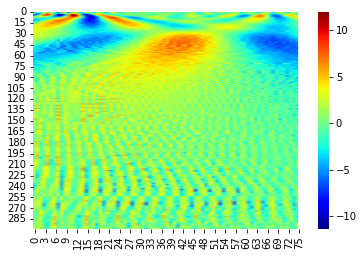

In [57]:
coef, freqs = pywt.cwt(compon_matrix[0], np.arange(1,300), "morl")
sns.heatmap(coef, cmap='jet', shading='gouraud')
pd.DataFrame(coef)

,0,1,2,3
0,-3.169090,0.011589,-0.229303,2.901902
1,-4.017783,-0.449336,0.751945,1.554273
2,3.983441,-8.119500,-0.380575,-1.098435
3,3.547547,-8.020009,0.403778,0.385090
4,3.369652,-6.466816,1.380896,0.636040
...,...,...,...,...
71,-4.680829,-0.061778,-2.869091,3.421714
72,-0.233752,0.258318,3.689666,-4.809034
73,-0.611239,-0.085036,3.203679,-5.680702
74,2.885814,11.282351,8.038003,20.658636
